# Data Loading

In [1]:
import os
import glob
import pandas as pd
import json

# Path to the directory containing the JSON files
folder_path =  './../results/'

# Get all JSON files in the directory
json_files = glob.glob(os.path.join(folder_path, '*.json'))

# Initialize empty lists to store DataFrames
client_dfs = []
server_dfs = []
central_dfs = []

# Iterate through each JSON file
for file in json_files:
    with open(file, 'r') as f:
        data = json.load(f)
    
    # Read JSON data and convert it to DataFrame
    df = pd.json_normalize(data)
    
    # Check the name to decide which DataFrame to append to
    if os.path.basename(file).startswith('concept_shift_on_labels_client'):
        client_dfs.append(df)
    elif os.path.basename(file).startswith('concept_shift_on_labels_server'):
        server_dfs.append(df)
    elif os.path.basename(file).startswith('concept_shift_on_labels_central'):
        central_dfs.append(df)
    #elif os.path.basename(file).startswith('central'):
    #    central_dfs.append(df)


# Concatenate the lists of DataFrames into single DataFrames
client_df = pd.concat(client_dfs, ignore_index=True)
server_df = pd.concat(server_dfs, ignore_index=True)
central_df = pd.concat(central_dfs, ignore_index=True)

# Now you have three DataFrames: client_df, server_df, and central_df
# Columns to drop
client_columns_to_drop = ["output", "heterogeneity", "type", "seed","federated_rounds","federated_local_epochs","num_clusters"]
client_df.drop(columns=client_columns_to_drop, inplace=True)
server_columns_to_drop = ["output", "heterogeneity", "type", "seed","num_clusters"]
server_df.drop(columns=server_columns_to_drop, inplace=True)

new_column_names = {"num_clients": "clients", "num_samples_by_label": "samples"}
central_df.rename(columns=new_column_names, inplace=True)
# Rename the columns in each DataFrame
new_column_names = {"num_clients": "clients", "num_samples_by_label": "samples","davies_bouldin_index": "dbi"}
client_df.rename(columns=new_column_names, inplace=True)
server_df.rename(columns=new_column_names, inplace=True)
central_df.transpose()


,0,1
seed,42,42
clients,240,48
samples,20,100
centralized_model_epochs,200,200
federated_rounds,200,100
federated_local_epochs,10,50
num_clusters,6,6
output,concept_shift_on_labels_central240,concept_shift_on_labels_central48
heterogeneity,concept_shift_on_labels,concept_shift_on_labels
type,central,central


# CENTRALIZED/ CLASSIC FL

In [2]:
central_df = central_df.sort_values(by='clients', ascending=False)
central_df['total'] = central_df['samples']*central_df['clients']
central_df = central_df.sort_values(by=['clients','total','samples'], ascending=True)
central_df.drop(columns=['seed','centralized_model_epochs','federated_rounds',	'federated_local_epochs','num_clusters','output','heterogeneity','type','federated std'], inplace=True)
central_df.transpose()

,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
central,68.194444,69.930556
"personalized central ((1, 7))",94.791667,94.625000
"federated (1, 7)",94.833333,93.500000
"personalized central ((7, 9))",93.541667,94.166667
"federated (7, 9)",93.500000,93.916667
"personalized central ((4, 7))",94.500000,93.791667
"federated (4, 7)",93.875000,92.625000
"personalized central ((5, 6))",93.958333,94.250000


In [3]:
import numpy as np
# Assuming central_df is your DataFrame
# Replace 'central_df' with the name of your DataFrame
columns_with_personalized = [col for col in central_df.columns if 'personalized central ' in col]
columns_with_fed = [col for col in central_df.columns if 'federated ' in col]

# Calculate mean and standard deviation for each column with 'personalized central'
mean_values = central_df[columns_with_personalized].mean(axis=1)
std_values = central_df[columns_with_personalized].std(axis=1)
                    

# Inject mean and standard deviation as new columns
central_df['mean_personalized'] = mean_values
central_df['std_personalized'] = std_values

# Calculate mean and standard deviation for each column with 'federated'
mean_values_fed = central_df[columns_with_fed].mean(axis=1)
std_values_fed = central_df[columns_with_fed].std(axis=1)
# Inject mean and standard deviation as new columns
central_df['mean_federated_personalized'] = mean_values_fed
central_df['std_federated_personalized'] = std_values_fed


central_df.transpose()


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
central,68.194444,69.930556
"personalized central ((1, 7))",94.791667,94.625000
"federated (1, 7)",94.833333,93.500000
"personalized central ((7, 9))",93.541667,94.166667
"federated (7, 9)",93.500000,93.916667
"personalized central ((4, 7))",94.500000,93.791667
"federated (4, 7)",93.875000,92.625000
"personalized central ((5, 6))",93.958333,94.250000


# CFL CLIENT SIDE

In [4]:
client_df['total'] = client_df['samples']*client_df['clients']
client_df = client_df.sort_values(by=['total','samples'], ascending=True)
print('CLIENT SIDE')
display(client_df.transpose())


CLIENT SIDE


,0,1
clients,240,48
samples,20,100
silhouette,0.963911,0.964124
avg_intra_dist,0.245947,0.815945
duhn_index,12.199125,10.96513
dbi,None,None
Cluster 0.num_members,119,24
Cluster 0.accuracy,70.938375,72.152778
Cluster 0.std,9.919467,6.442753
"Cluster 0.members_heterogeneity.(3, 8)",40,8


In [5]:
from IPython.display import display
client_df = client_df.sort_values(by='clients', ascending=True)
# Select the columns for each DataFrame
display(client_df[['clients','samples','silhouette',	'avg_intra_dist',	'duhn_index', 'dbi']])
# Create new DataFrames
cluster_columns = [col for col in client_df.columns if col.startswith('Cluster')]
cluster_dfs = {}
for i in range(4):  # Assuming you want to create 4 new DataFrames
    cluster_dfs[i] = client_df[['clients', 'samples'] + [col for col in cluster_columns if col.startswith(f'Cluster {i}')]]
    display(cluster_dfs[i].transpose())

,clients,samples,silhouette,avg_intra_dist,duhn_index,dbi
1,48,100,0.964124,0.815945,10.965130,None
0,240,20,0.963911,0.245947,12.199125,None


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 0.num_members,24.000000,119.000000
Cluster 0.accuracy,72.152778,70.938375
Cluster 0.std,6.442753,9.919467
"Cluster 0.members_heterogeneity.(3, 8)",8.000000,40.000000
"Cluster 0.members_heterogeneity.(5, 6)",8.000000,40.000000
"Cluster 0.members_heterogeneity.(7, 9)",8.000000,39.000000


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 1.num_members,2.000000,2.000000
Cluster 1.accuracy,87.166667,71.666667
Cluster 1.std,0.166667,10.000000
"Cluster 1.members_heterogeneity.(1, 7)",2.000000,1.000000
"Cluster 1.members_heterogeneity.(7, 9)",NaN,1.000000


,1,0
clients,48,240
samples,100,20


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 3.num_members,6.000000,39.000000
Cluster 3.accuracy,92.833333,92.350427
Cluster 3.std,1.258306,3.327301
"Cluster 3.members_heterogeneity.(1, 7)",6.000000,39.000000


In [6]:
display(client_df[['Cluster 0.accuracy','Cluster 1.accuracy','Cluster 3.accuracy','Cluster 4.accuracy','Cluster 5.accuracy']].mean(axis=1))
client_df[['Cluster 0.accuracy','Cluster 1.accuracy','Cluster 3.accuracy','Cluster 4.accuracy','Cluster 5.accuracy']].std(axis=1)

1    87.872222
0    84.307761
dtype: float64

1     9.192280
0    11.882428
dtype: float64

## Histogram Client SIDE

In [7]:
client_df

,clients,samples,silhouette,avg_intra_dist,duhn_index,dbi,Cluster 0.num_members,Cluster 0.accuracy,Cluster 0.std,"Cluster 0.members_heterogeneity.(3, 8)",...,"Cluster 3.members_heterogeneity.(1, 7)",Cluster 4.num_members,Cluster 4.accuracy,Cluster 4.std,"Cluster 4.members_heterogeneity.(4, 7)",Cluster 5.num_members,Cluster 5.accuracy,Cluster 5.std,"Cluster 5.members_heterogeneity.(2, 7)",total
1,48,100,0.964124,0.815945,10.965130,None,24,72.152778,6.442753,8,...,6,8,93.791667,0.762625,8,8,93.416667,1.497683,8,4800
0,240,20,0.963911,0.245947,12.199125,None,119,70.938375,9.919467,40,...,39,40,93.041667,2.978802,40,40,93.541667,3.054766,40,4800


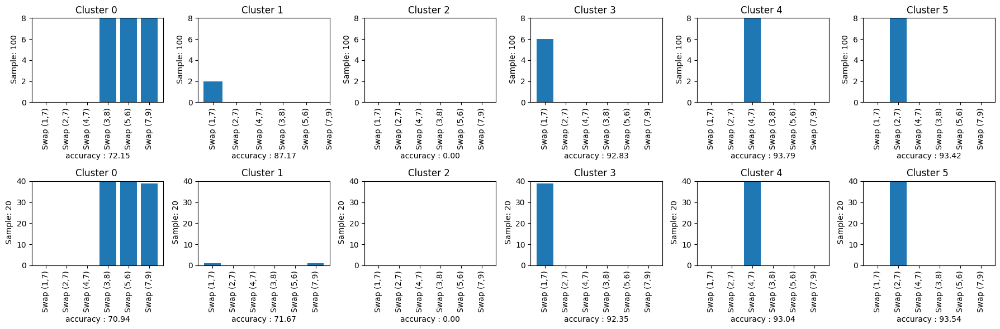

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
# Assuming your DataFrame is named df
df = client_df

# Add new columns and set values to 0

# Selecting the columns of interest for each cluster
columns_of_interest_cluster0 = ['Cluster 0.members_heterogeneity.(1, 7)',
                                'Cluster 0.members_heterogeneity.(2, 7)',
                                'Cluster 0.members_heterogeneity.(4, 7)', 
                                'Cluster 0.members_heterogeneity.(3, 8)',
                                'Cluster 0.members_heterogeneity.(5, 6)'
                                ,'Cluster 0.members_heterogeneity.(7, 9)']

columns_of_interest_cluster1 = ['Cluster 1.members_heterogeneity.(1, 7)',
                                'Cluster 1.members_heterogeneity.(2, 7)', 
                                'Cluster 1.members_heterogeneity.(4, 7)',  
                                'Cluster 1.members_heterogeneity.(3, 8)',
                                'Cluster 1.members_heterogeneity.(5, 6)'
                                ,'Cluster 1.members_heterogeneity.(7, 9)']

columns_of_interest_cluster2 = ['Cluster 2.members_heterogeneity.(1, 7)', 
                                'Cluster 2.members_heterogeneity.(2, 7)', 
                                'Cluster 2.members_heterogeneity.(4, 7)', 
                                'Cluster 2.members_heterogeneity.(3, 8)',
                                'Cluster 2.members_heterogeneity.(5, 6)',
                                'Cluster 2.members_heterogeneity.(7, 9)']
columns_of_interest_cluster3 = ['Cluster 3.members_heterogeneity.(1, 7)',
                                'Cluster 3.members_heterogeneity.(2, 7)', 
                                'Cluster 3.members_heterogeneity.(4, 7)',  
                                'Cluster 3.members_heterogeneity.(3, 8)',
                                'Cluster 3.members_heterogeneity.(5, 6)',
                                'Cluster 3.members_heterogeneity.(7, 9)']
columns_of_interest_cluster4 = ['Cluster 4.members_heterogeneity.(1, 7)',
                                'Cluster 4.members_heterogeneity.(2, 7)', 
                                'Cluster 4.members_heterogeneity.(4, 7)',  
                                'Cluster 4.members_heterogeneity.(3, 8)',
                                'Cluster 4.members_heterogeneity.(5, 6)',
                                'Cluster 4.members_heterogeneity.(7, 9)']
columns_of_interest_cluster5 = ['Cluster 5.members_heterogeneity.(1, 7)',
                                'Cluster 5.members_heterogeneity.(2, 7)', 
                                'Cluster 5.members_heterogeneity.(4, 7)',  
                                'Cluster 5.members_heterogeneity.(3, 8)',
                                'Cluster 5.members_heterogeneity.(5, 6)',
                                'Cluster 5.members_heterogeneity.(7, 9)']
columns_to_search = columns_of_interest_cluster0+ columns_of_interest_cluster1 +columns_of_interest_cluster2 + columns_of_interest_cluster3 + columns_of_interest_cluster4 +columns_of_interest_cluster5+ ['Cluster 2.accuracy']
for column in columns_to_search:
    if column not in df.columns:
        df[column] = 0
# Creating subplots
fig, axs = plt.subplots(len(df), len(columns_of_interest_cluster0), figsize=(3*len(columns_of_interest_cluster0), 3*len(df)))

# Plotting bar plots for each row and each cluster
for i, (index, row) in enumerate(df.iterrows()):
    sample_name = row['samples']  # Get the value of 'samples' column for the current row
    max_value = max(row[columns_of_interest_cluster0].max(),
                    row[columns_of_interest_cluster1].max(),
                    row[columns_of_interest_cluster2].max(),row[columns_of_interest_cluster3].max())
    
    for j, columns_of_interest in enumerate([columns_of_interest_cluster0,
                                             columns_of_interest_cluster1,
                                             columns_of_interest_cluster2,columns_of_interest_cluster3,columns_of_interest_cluster4,columns_of_interest_cluster5]):
        axs[i, j].bar(range(len(columns_of_interest)), row[columns_of_interest], align='center')
        axs[i, j].set_xticks(range(len(columns_of_interest)))
        axs[i, j].set_xticklabels(['Swap (1,7)','Swap (2,7)','Swap (4,7)', 'Swap (3,8)', 'Swap (5,6)', 'Swap (7,9)'], rotation=90)
        axs[i, j].set_title(f"Cluster {j} ")
        accuracy = row[f'Cluster {j}.accuracy']
        axs[i, j].set_xlabel(f"accuracy : {accuracy:.2f}")
        axs[i, j].set_ylabel(f" Sample: {sample_name}")
        axs[i, j].set_ylim(0, max_value)  # Set y-axis limits to the maximum value across all clusters

plt.tight_layout()
plt.show()

C:\Users\mbenali\AppData\Local\Temp\ipykernel_18696\2786176075.py:62: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


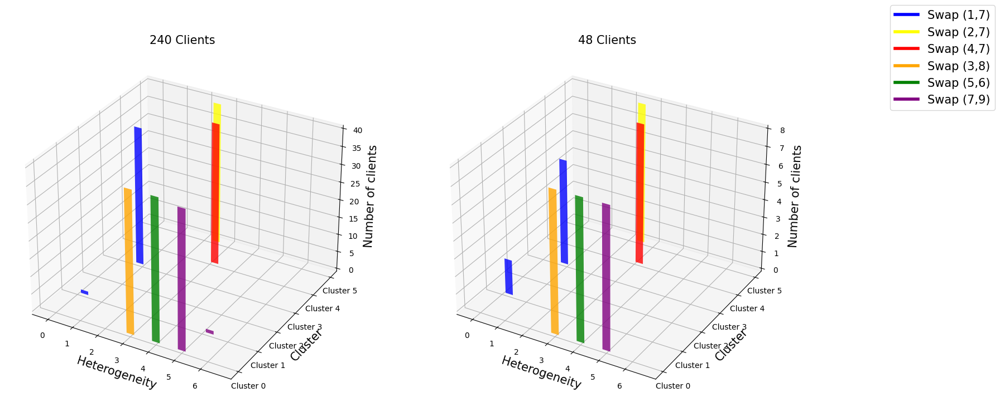

In [9]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd

# Assume client_df is already loaded and contains the data
# Sample structure of client_df
# client_df = pd.DataFrame({...})

# Data extraction and organization
clusters = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5']
clients = ['240 Clients', '48 Clients']
samples = [240, 48]  # Representing the number of clients

# Mapping clusters to their respective conditions in the DataFrame
cluster_conditions = {
    'Cluster 0': columns_of_interest_cluster0,
    'Cluster 1': columns_of_interest_cluster1,
    'Cluster 2': columns_of_interest_cluster2,
    'Cluster 3': columns_of_interest_cluster3,
    'Cluster 4': columns_of_interest_cluster4,
    'Cluster 5': columns_of_interest_cluster5
}

colors = ['blue', 'yellow', 'red', 'orange', 'green', 'purple']
conditions = ['Swap (1,7)', 'Swap (2,7)', 'Swap (4,7)', 'Swap (3,8)', 'Swap (5,6)', 'Swap (7,9)']

fig = plt.figure(figsize=(18, 10))

# Set font size
font_size = 15

# Create subplots for each client type
for i, client in enumerate(clients):
    ax = fig.add_subplot(1, 2, i + 1, projection='3d')

    for j, cluster in enumerate(clusters):
        y_pos = np.arange(len(cluster_conditions[cluster]))
        count = []
        for cond in cluster_conditions[cluster]:
            if cond in client_df.columns:
                value = client_df.loc[client_df['clients'] == samples[i], cond].values[0]
                count.append(value if not pd.isna(value) else 0)
            else:
                count.append(0)
        
        ax.bar(y_pos + j * 0.3, count, zs=j, zdir='y', color=colors, alpha=0.8, width=0.3)

    ax.set_xlabel('Heterogeneity', fontsize=font_size)
    ax.set_ylabel('Cluster', fontsize=font_size)
    ax.set_zlabel('Number of clients', fontsize=font_size)

    ax.set_title(f'{client}', fontsize=font_size)
    ax.set_yticks(np.arange(len(clusters)))
    ax.set_yticklabels(clusters)

# Adding legend for heterogeneity types
legend_labels = conditions
legend_patches = [plt.Line2D([0], [0], color=color, lw=4) for color in colors]
fig.legend(legend_patches, legend_labels, loc='upper left', bbox_to_anchor=(1, 0.9), fontsize=font_size)

plt.tight_layout()
plt.show()


C:\Users\mbenali\AppData\Local\Temp\ipykernel_18696\1153985711.py:58: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] * len(ax.get_yticks()))
C:\Users\mbenali\AppData\Local\Temp\ipykernel_18696\1153985711.py:63: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


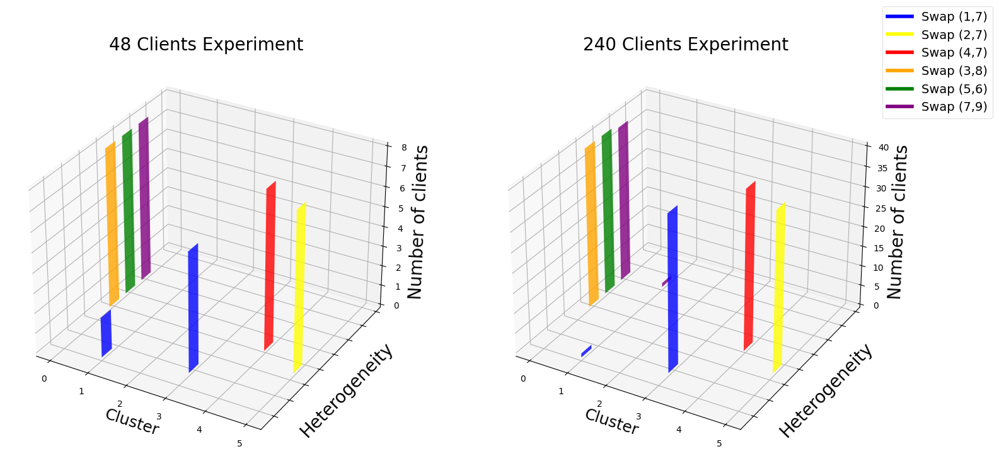

In [12]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd

# Assume client_df is already loaded and contains the data
# Sample structure of client_df
# client_df = pd.DataFrame({...})

# Data extraction and organization
clusters = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5']
clients = ['48 Clients Experiment','240 Clients Experiment']
samples = [48, 240]  # Representing the number of clients

# Mapping clusters to their respective conditions in the DataFrame
cluster_conditions = {
    'Cluster 0': columns_of_interest_cluster0,
    'Cluster 1': columns_of_interest_cluster1,
    'Cluster 2': columns_of_interest_cluster2,
    'Cluster 3': columns_of_interest_cluster3,
    'Cluster 4': columns_of_interest_cluster4,
    'Cluster 5': columns_of_interest_cluster5
}

colors = ['blue', 'yellow', 'red', 'orange', 'green', 'purple']
conditions = ['Swap (1,7)', 'Swap (2,7)', 'Swap (4,7)', 'Swap (3,8)', 'Swap (5,6)', 'Swap (7,9)']

fig = plt.figure(figsize=(18, 10))

# Set font size
font_size = 20

# Create subplots for each client type
for i, client in enumerate(clients):
    ax = fig.add_subplot(1, 2, i + 1, projection='3d')

    for j, cluster in enumerate(clusters):
        x_pos = np.arange(len(cluster_conditions[cluster]))
        count = []
        for cond in cluster_conditions[cluster]:
            if cond in client_df.columns:
                value = client_df.loc[client_df['clients'] == samples[i], cond].values[0]
                count.append(value if not pd.isna(value) else 0)
            else:
                count.append(0)
        
        ax.bar(x_pos + j * 0.3, count, zs=j, zdir='x', color=colors, alpha=0.8, width=0.6)  # Doubling the bar width

    ax.set_xlabel('Cluster', fontsize=0.9*font_size)
    ax.set_ylabel('Heterogeneity', fontsize=font_size)
    ax.set_zlabel('Number of clients', fontsize=font_size)

    ax.set_title(f'{client}', fontsize=font_size)
    ax.set_xticks(np.arange(len(clusters)))
    #ax.set_xticklabels(clusters)
    #ax.set_yticks(np.arange(len(conditions)))
    #ax.set_yticklabels(conditions)
    ax.set_yticklabels([''] * len(ax.get_yticks()))
# Adding legend for heterogeneity types
legend_labels = conditions
legend_patches = [plt.Line2D([0], [0], color=color, lw=4) for color in colors]
fig.legend(legend_patches, legend_labels, loc='upper right', bbox_to_anchor=(1, 0.9), fontsize=0.7*font_size,framealpha=0.5)
plt.tight_layout()
plt.show()

## Plot T-SNE Client SIDE

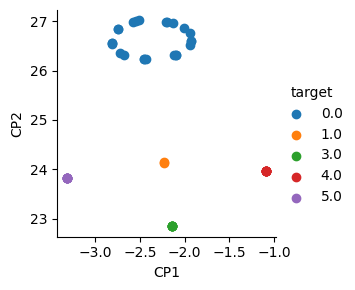

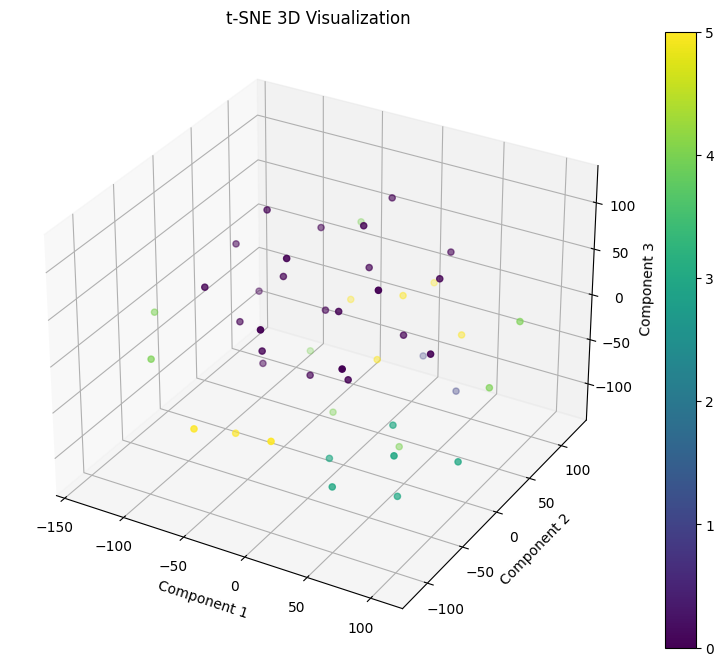

In [10]:
import pickle
import pandas as pd
df = pd.read_pickle('./../results/concept_shift_on_labels_client48_client_weights.pkl')
cluster = df['cluster']
df.drop(columns='cluster')
print('')
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import datasets
from sklearn import manifold
import sklearn.manifold._t_sne as tsne
X = df
y= cluster
tsne = manifold.TSNE(n_components=2, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2', 'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
grid = sns.FacetGrid(tsne_df, hue="target")
grid.map(plt.scatter, 'CP1', 'CP2').add_legend()
X = df
y= cluster
tsne = manifold.TSNE(n_components=3, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2','CP3' ,'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatter plot using Matplotlib directly
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data points
scatter = ax.scatter(tsne_df['CP1'], tsne_df['CP2'], tsne_df['CP3'], c=tsne_df['target'], cmap='viridis')

# Set labels and title
ax.set_xlabel('Component 1')
ax.set_ylabel('Component 2')
ax.set_zlabel('Component 3')
ax.set_title('t-SNE 3D Visualization')

# Add color bar
plt.colorbar(scatter)

plt.show()

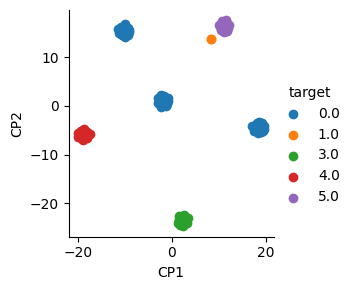

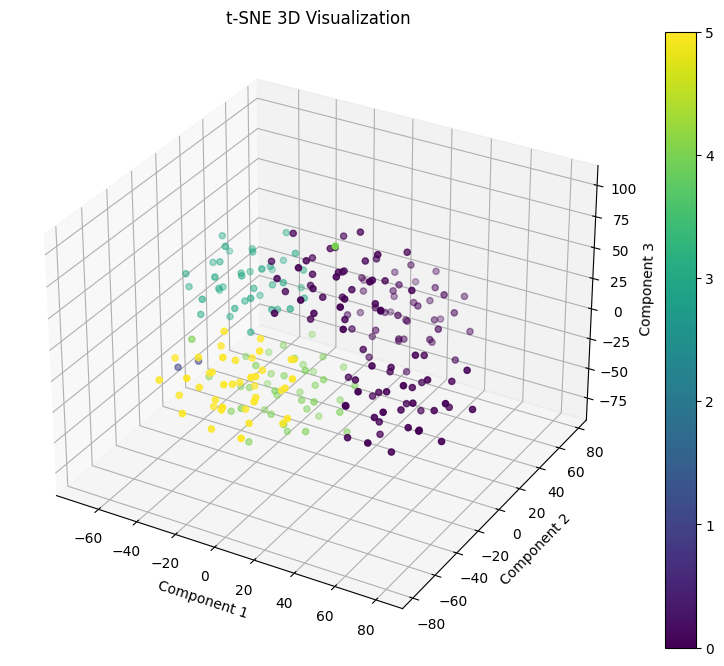

In [11]:
import pickle
import pandas as pd
df = pd.read_pickle('./../results/concept_shift_on_labels_client240_client_weights.pkl')
cluster = df['cluster']
df.drop(columns='cluster')
print('')
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import datasets
from sklearn import manifold
import sklearn.manifold._t_sne as tsne
X = df
y= cluster
tsne = manifold.TSNE(n_components=2, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2', 'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
grid = sns.FacetGrid(tsne_df, hue="target")
grid.map(plt.scatter, 'CP1', 'CP2').add_legend()
X = df
y= cluster
tsne = manifold.TSNE(n_components=3, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2','CP3' ,'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatter plot using Matplotlib directly
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data points
scatter = ax.scatter(tsne_df['CP1'], tsne_df['CP2'], tsne_df['CP3'], c=tsne_df['target'], cmap='viridis')

# Set labels and title
ax.set_xlabel('Component 1')
ax.set_ylabel('Component 2')
ax.set_zlabel('Component 3')
ax.set_title('t-SNE 3D Visualization')

# Add color bar
plt.colorbar(scatter)

plt.show()

## Plot weight heatmap Client SIDE

In [17]:
import torch
import glob
import os

from src.models import SimpleLinear
from src.metrics import plot_weights_heatmap
model = SimpleLinear()

# Define the directories
central_dir = "./results/concept_shift_on_labels_central"
client_dir = "./results/concept_shift_on_labels_client"
server_dir = "./results/concept_shift_on_labels_server"

# Function to load .pth files from a directory into a dictionary
def load_pth_files(directory):
    pth_files = glob.glob(directory + "*.pth")
    models_dict = {}
    for pth_file in pth_files:
        filename = os.path.basename(pth_file)[:-4]  # Remove ".pth" extension
        model = torch.load(pth_file)
        models_dict[filename] = model
    return models_dict

# Load models from each directory
central_models_dict = load_pth_files(central_dir)
client_models_dict = load_pth_files(client_dir)
server_models_dict = load_pth_files(server_dir)

In [18]:
import matplotlib.pyplot as plt
def plot_weights_heatmap(model,title,title2 = '', v_value=0.1 ):
    # Get the weights of the first and second layers
    first_layer_weights = model.fc1.weight.data.numpy()
    second_layer_weights = model.fc2.weight.data.numpy()

    # Create custom colormap
    cmap = 'coolwarm'

    # Plot the input weights of the first layer
    plt.figure(figsize=(5, 3))

    #plt.subplot(2, 1, 1)
    plt.imshow(first_layer_weights, cmap=cmap, aspect='auto', vmin=-v_value, vmax=v_value)
    plt.title(title)
    plt.xlabel('Input Pixel (784)')
    plt.ylabel('Neuron in Hidden Layer (200)')
    plt.colorbar(label='Weight Value')
    plt.tight_layout()
    #plt.savefig(title + '.jpg')  
    plt.show()
'''
    # Plot the output weights of the second layer
    plt.subplot(2, 1, 2)
    plt.imshow(second_layer_weights, cmap=cmap, aspect='auto', vmin=-v_value, vmax=v_value)
    plt.title(title2)
    plt.xlabel('Neuron in Hidden Layer(200)')
    plt.ylabel('Output Neuron (10)')
    plt.colorbar(label='Weight Value')

    plt.tight_layout()
    #plt.savefig(title + '.jpg')  
    plt.show()
    '''

"\n    # Plot the output weights of the second layer\n    plt.subplot(2, 1, 2)\n    plt.imshow(second_layer_weights, cmap=cmap, aspect='auto', vmin=-v_value, vmax=v_value)\n    plt.title(title2)\n    plt.xlabel('Neuron in Hidden Layer(200)')\n    plt.ylabel('Output Neuron (10)')\n    plt.colorbar(label='Weight Value')\n\n    plt.tight_layout()\n    #plt.savefig(title + '.jpg')  \n    plt.show()\n    "

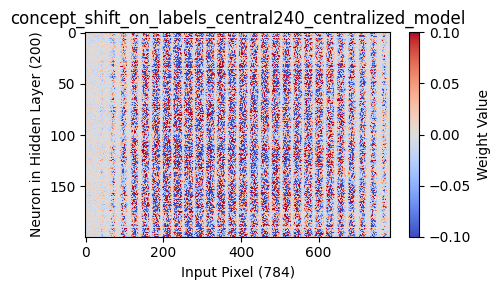

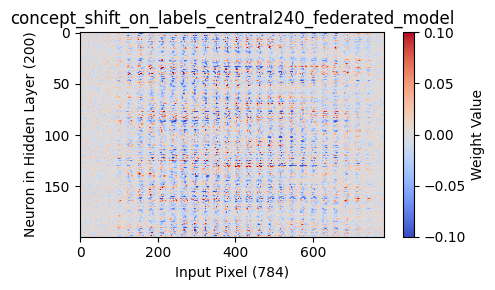

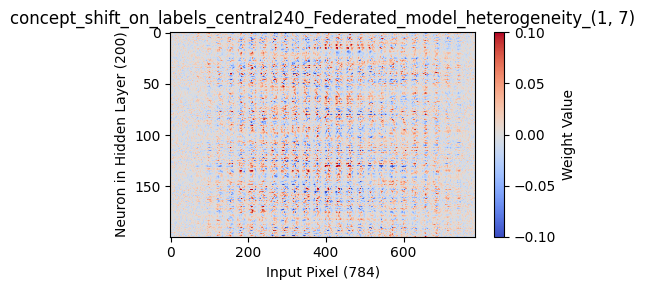

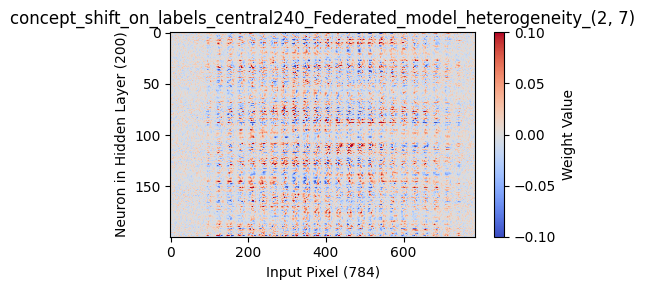

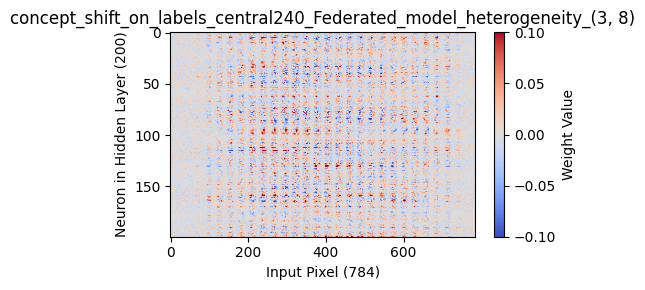

...

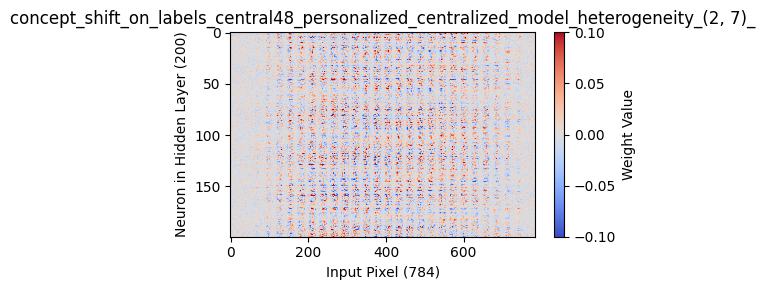

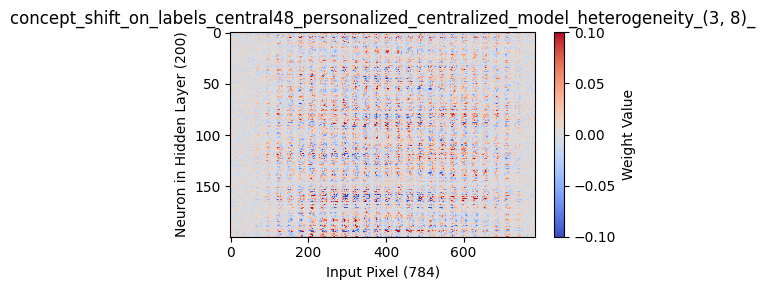

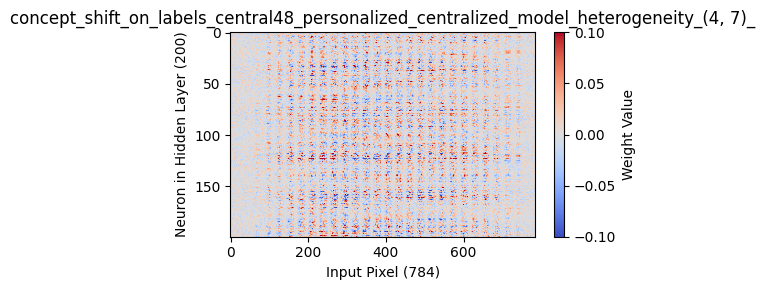

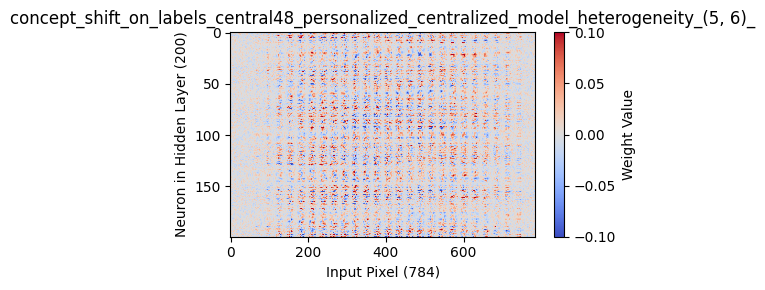

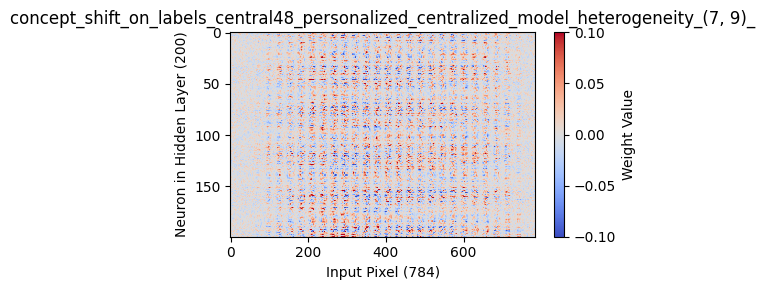

In [19]:
key_list =[]
for key in central_models_dict.keys() :
    key_list.append(key)
for key in key_list :
    model.load_state_dict(central_models_dict[key])
    plot_weights_heatmap(model,key)

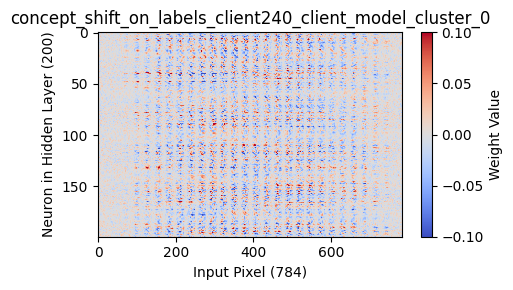

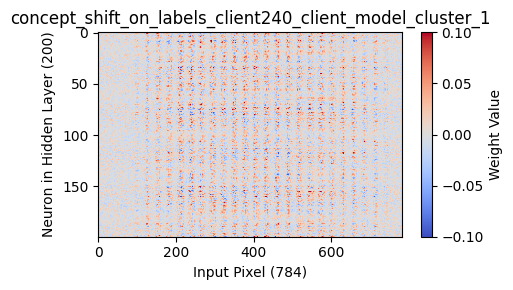

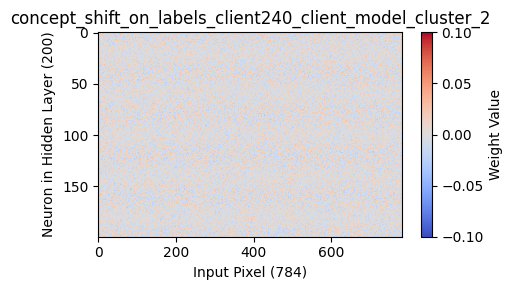

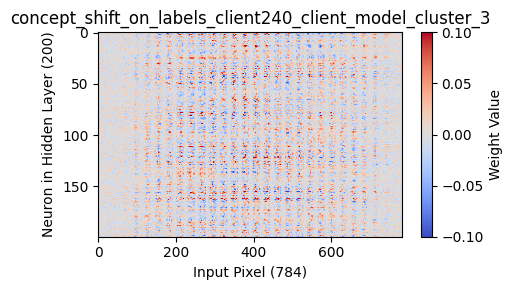

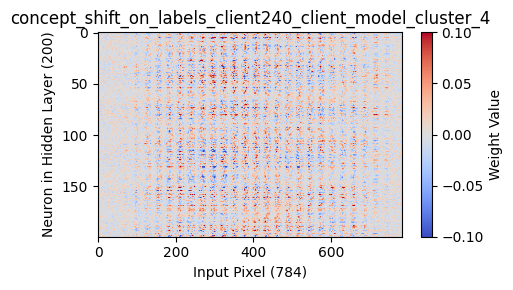

...

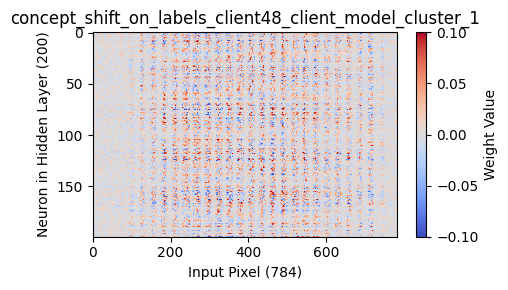

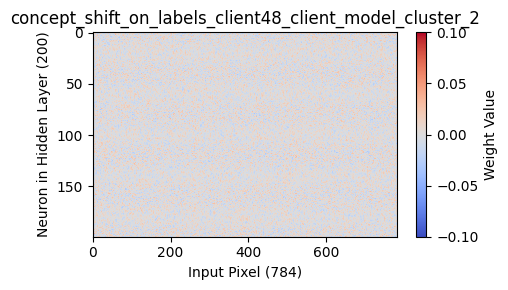

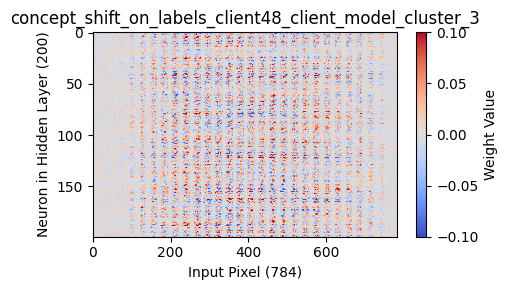

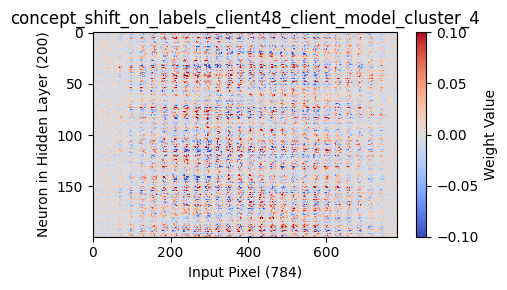

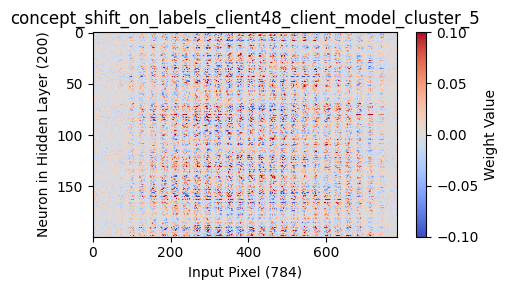

In [20]:
key_list =[]
for key in client_models_dict.keys() :
    key_list.append(key)
for key in key_list :
    model.load_state_dict(client_models_dict[key])
    plot_weights_heatmap(model,key)

# CFL SERVER SIDE

In [11]:
server_df['total'] = server_df['samples']*server_df['clients']
print('SERVERSIDE')
server_df = server_df.sort_values(by=['total','samples'], ascending=True)
display(server_df.transpose())

SERVERSIDE


,0,1
clients,240.000000,48.000000
samples,20.000000,100.000000
cfl_before_cluster_rounds,100.000000,50.000000
cfl_after_cluster_rounds,100.000000,50.000000
cfl_local_epochs,10.000000,50.000000
silhouette,0.954447,0.962031
avg_intra_dist,0.009653,0.014031
duhn_index,13.042364,20.619495
dbi,0.061429,0.049554
Cluster 0.num_members,40.000000,8.000000


In [13]:
from IPython.display import display
server_df = server_df.sort_values(by='clients', ascending=True)
# Select the columns for each DataFrame
display(server_df[['clients','samples','silhouette',	'avg_intra_dist',	'duhn_index', 'dbi']])
# Create new DataFrames
cluster_columns = [col for col in server_df.columns if col.startswith('Cluster')]
cluster_dfs = {}
for i in range(6):  # Assuming you want to create 4 new DataFrames
    cluster_dfs[i] = server_df[['clients', 'samples'] + [col for col in cluster_columns if col.startswith(f'Cluster {i}')]]
    display(cluster_dfs[i].transpose())

,clients,samples,silhouette,avg_intra_dist,duhn_index,dbi
1,48,100,0.962031,0.014031,20.619495,0.049554
0,240,20,0.954447,0.009653,13.042364,0.061429


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 0.num_members,8.000000,40.000000
Cluster 0.accuracy,94.791667,94.875000
Cluster 0.std,0.832291,2.565462
"Cluster 0.members_heterogeneity.(4, 7)",8.000000,40.000000


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 1.num_members,8.000000,40.000000
Cluster 1.accuracy,94.833333,94.625000
Cluster 1.std,1.092906,2.400448
"Cluster 1.members_heterogeneity.(5, 6)",8.000000,40.000000


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 2.num_members,8.000000,40.000000
Cluster 2.accuracy,96.541667,93.500000
Cluster 2.std,0.927025,3.431877
"Cluster 2.members_heterogeneity.(1, 7)",8.000000,40.000000


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 3.num_members,8.000000,40.000000
Cluster 3.accuracy,95.500000,93.958333
Cluster 3.std,1.414214,3.177339
"Cluster 3.members_heterogeneity.(3, 8)",8.000000,40.000000


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 4.num_members,8.000000,40.000000
Cluster 4.accuracy,95.541667,93.666667
Cluster 4.std,1.423391,3.144660
"Cluster 4.members_heterogeneity.(7, 9)",8.000000,40.000000


,1,0
clients,48.000000,240.000000
samples,100.000000,20.000000
Cluster 5.num_members,8.000000,40.000000
Cluster 5.accuracy,96.000000,93.958333
Cluster 5.std,1.142609,3.177339
"Cluster 5.members_heterogeneity.(2, 7)",8.000000,40.000000


In [14]:
display(server_df[['Cluster 0.accuracy','Cluster 1.accuracy','Cluster 2.accuracy','Cluster 3.accuracy','Cluster 4.accuracy','Cluster 5.accuracy']].mean(axis=1))
server_df[['Cluster 0.accuracy','Cluster 1.accuracy','Cluster 2.accuracy','Cluster 3.accuracy','Cluster 4.accuracy','Cluster 5.accuracy']].std(axis=1)

1    95.534722
0    94.097222
dtype: float64

1    0.674648
0    0.541132
dtype: float64

## Histogram Server SIDE

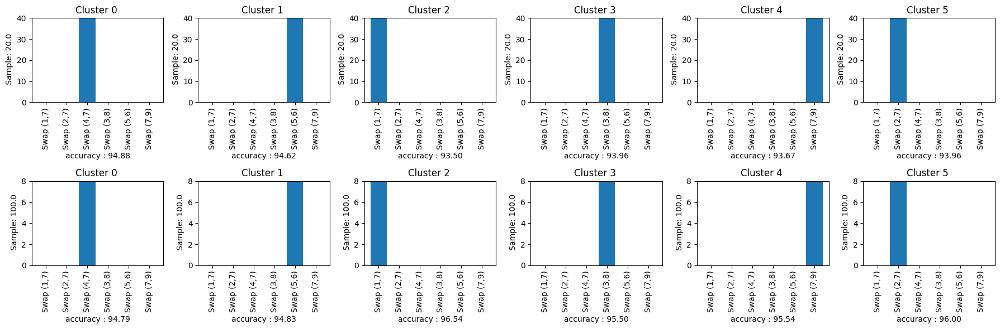

In [5]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming your DataFrame is named df
df = server_df

# Add new columns and set values to 0
#new_columns = ['Cluster 2.members_heterogeneity.dilatation', 'Cluster 2.members_heterogeneity.none']
#df = df.assign(**{col: 0 for col in new_columns})

# Selecting the columns of interest for each cluster
columns_of_interest_cluster0 = ['Cluster 0.members_heterogeneity.(1, 7)',
                                'Cluster 0.members_heterogeneity.(2, 7)',
                                'Cluster 0.members_heterogeneity.(4, 7)', 
                                'Cluster 0.members_heterogeneity.(3, 8)',
                                'Cluster 0.members_heterogeneity.(5 ,6)'
                                ,'Cluster 0.members_heterogeneity.(7, 9)']

columns_of_interest_cluster1 = ['Cluster 1.members_heterogeneity.(1, 7)',
                                'Cluster 1.members_heterogeneity.(2, 7)', 
                                'Cluster 1.members_heterogeneity.(4, 7)',  
                                'Cluster 1.members_heterogeneity.(3, 8)',
                                'Cluster 1.members_heterogeneity.(5, 6)'
                                ,'Cluster 1.members_heterogeneity.(7, 9)']

columns_of_interest_cluster2 = ['Cluster 2.members_heterogeneity.(1, 7)', 
                                'Cluster 2.members_heterogeneity.(2, 7)', 
                                'Cluster 2.members_heterogeneity.(4, 7)', 
                                'Cluster 2.members_heterogeneity.(3, 8)',
                                'Cluster 2.members_heterogeneity.(5, 6)',
                                'Cluster 2.members_heterogeneity.(7 9)']
columns_of_interest_cluster3 = ['Cluster 3.members_heterogeneity.(1, 7)',
                                'Cluster 3.members_heterogeneity.(2, 7)', 
                                'Cluster 3.members_heterogeneity.(4, 7)',  
                                'Cluster 3.members_heterogeneity.(3, 8)',
                                'Cluster 3.members_heterogeneity.(5, 6)',
                                'Cluster 3.members_heterogeneity.(7, 9)']
columns_of_interest_cluster4 = ['Cluster 4.members_heterogeneity.(1, 7)',
                                'Cluster 4.members_heterogeneity.(2, 7)', 
                                'Cluster 4.members_heterogeneity.(4, 7)',  
                                'Cluster 4.members_heterogeneity.(3, 8)',
                                'Cluster 4.members_heterogeneity.(5, 6)',
                                'Cluster 4.members_heterogeneity.(7, 9)']
columns_of_interest_cluster5 = ['Cluster 5.members_heterogeneity.(1, 7)',
                                'Cluster 5.members_heterogeneity.(2, 7)', 
                                'Cluster 5.members_heterogeneity.(4, 7)',  
                                'Cluster 5.members_heterogeneity.(3, 8)',
                                'Cluster 5.members_heterogeneity.(5, 6)',
                                'Cluster 5.members_heterogeneity.(7, 9)']
columns_to_search = columns_of_interest_cluster0+ columns_of_interest_cluster1 +columns_of_interest_cluster2 + columns_of_interest_cluster3 + columns_of_interest_cluster4 +columns_of_interest_cluster5
for column in columns_to_search:
    if column not in df.columns:
        df[column] = 0
# Creating subplots
fig, axs = plt.subplots(len(df), len(columns_of_interest_cluster0), figsize=(3*len(columns_of_interest_cluster0), 3*len(df)))

# Plotting bar plots for each row and each cluster
for i, (index, row) in enumerate(df.iterrows()):
    sample_name = row['samples']  # Get the value of 'samples' column for the current row
    max_value = max(row[columns_of_interest_cluster0].max(),
                    row[columns_of_interest_cluster1].max(),
                    row[columns_of_interest_cluster2].max(),row[columns_of_interest_cluster3].max())
    
    for j, columns_of_interest in enumerate([columns_of_interest_cluster0,
                                             columns_of_interest_cluster1,
                                             columns_of_interest_cluster2,columns_of_interest_cluster3,columns_of_interest_cluster4,columns_of_interest_cluster5]):
        axs[i, j].bar(range(len(columns_of_interest)), row[columns_of_interest], align='center')
        axs[i, j].set_xticks(range(len(columns_of_interest)))
        axs[i, j].set_xticklabels(['Swap (1,7)','Swap (2,7)','Swap (4,7)', 'Swap (3,8)', 'Swap (5,6)', 'Swap (7,9)'], rotation=90)
        axs[i, j].set_title(f"Cluster {j} ")
        accuracy = row[f'Cluster {j}.accuracy']
        axs[i, j].set_xlabel(f"accuracy : {accuracy:.2f}")
        axs[i, j].set_ylabel(f" Sample: {sample_name}")
        axs[i, j].set_ylim(0, max_value)  # Set y-axis limits to the maximum value across all clusters

plt.tight_layout()
plt.show()

In [12]:
cluster_conditions

{'Cluster 0': ['Cluster 0.members_heterogeneity(1, 7)',
  'Cluster 0.members_heterogeneity(2, 7)',
  'Cluster 0.members_heterogeneity(4, 7)',
  'Cluster 0.members_heterogeneity(3, 8)',
  'Cluster 0.members_heterogeneity(5, 6)',
  'Cluster 0.members_heterogeneity(7, 9)'],
 'Cluster 1': ['Cluster 1.members_heterogeneity(1, 7)',
  'Cluster 1.members_heterogeneity(2, 7)',
  'Cluster 1.members_heterogeneity(4, 7)',
  'Cluster 1.members_heterogeneity(3, 8)',
  'Cluster 1.members_heterogeneity(5, 6)',
  'Cluster 1.members_heterogeneity(7, 9)'],
 'Cluster 2': ['Cluster 2.members_heterogeneity(1, 7)',
  'Cluster 2.members_heterogeneity(2, 7)',
  'Cluster 2.members_heterogeneity(4, 7)',
  'Cluster 2.members_heterogeneity(3, 8)',
  'Cluster 2.members_heterogeneity(5, 6)',
  'Cluster 2.members_heterogeneity(7, 9)'],
 'Cluster 3': ['Cluster 3.members_heterogeneity(1, 7)',
  'Cluster 3.members_heterogeneity(2, 7)',
  'Cluster 3.members_heterogeneity(4, 7)',
  'Cluster 3.members_heterogeneity(3, 8)',

## Plot T-SNE Server SIDE

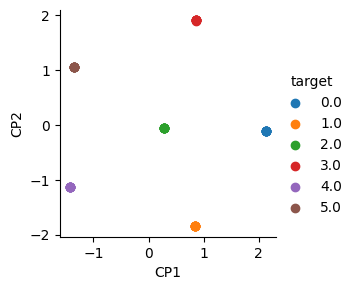

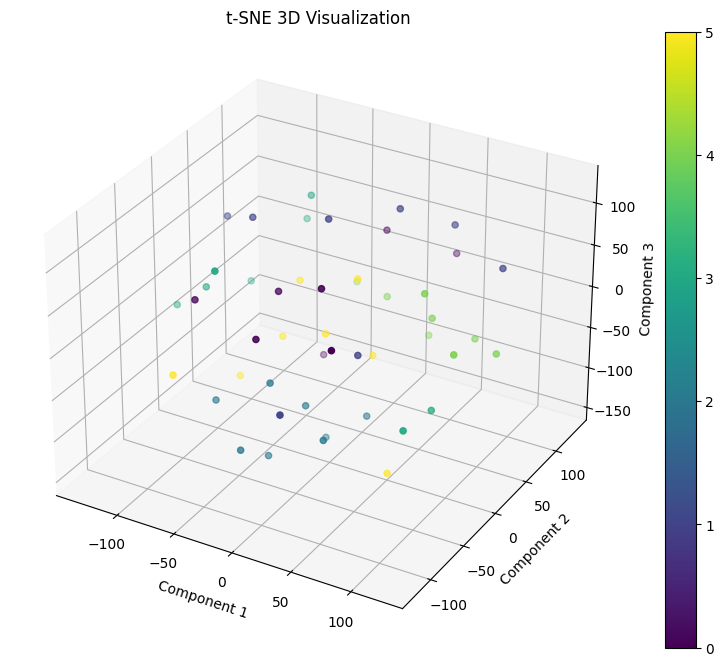

In [26]:
import pickle
import pandas as pd
df = pd.read_pickle('./../results/concept_shift_on_labels_server48_client_weights.pkl')
cluster = df['cluster']
df.drop(columns='cluster')
print('')
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import datasets
from sklearn import manifold
import sklearn.manifold._t_sne as tsne
X = df
y= cluster
tsne = manifold.TSNE(n_components=2, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2', 'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
grid = sns.FacetGrid(tsne_df, hue="target")
grid.map(plt.scatter, 'CP1', 'CP2').add_legend()
X = df
y= cluster
tsne = manifold.TSNE(n_components=3, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2','CP3' ,'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatter plot using Matplotlib directly
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data points
scatter = ax.scatter(tsne_df['CP1'], tsne_df['CP2'], tsne_df['CP3'], c=tsne_df['target'], cmap='viridis')

# Set labels and title
ax.set_xlabel('Component 1')
ax.set_ylabel('Component 2')
ax.set_zlabel('Component 3')
ax.set_title('t-SNE 3D Visualization')

# Add color bar
plt.colorbar(scatter)

plt.show()

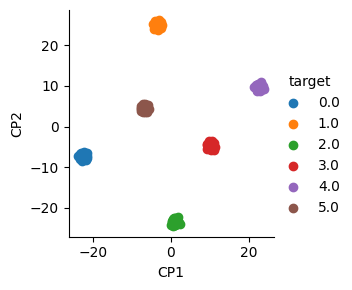

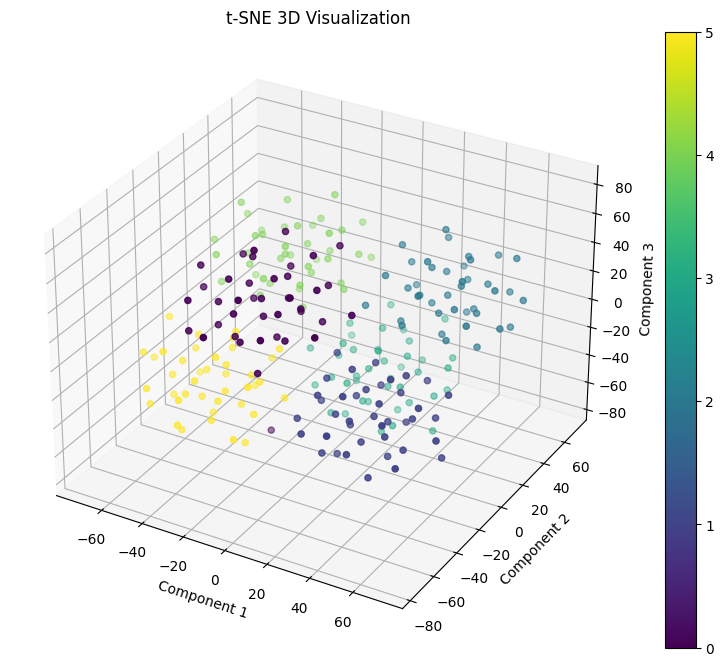

In [27]:
import pickle
import pandas as pd
df = pd.read_pickle('./../results/concept_shift_on_labels_server240_client_weights.pkl')
cluster = df['cluster']
df.drop(columns='cluster')
print('')
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import datasets
from sklearn import manifold
import sklearn.manifold._t_sne as tsne
X = df
y= cluster
tsne = manifold.TSNE(n_components=2, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2', 'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
grid = sns.FacetGrid(tsne_df, hue="target")
grid.map(plt.scatter, 'CP1', 'CP2').add_legend()
X = df
y= cluster
tsne = manifold.TSNE(n_components=3, random_state=42)
mnist_tr = tsne.fit_transform(X)
# create dataframe
tsne_df = pd.DataFrame(columns=['CP1', 'CP2','CP3' ,'target'],
                       data=np.column_stack((mnist_tr, 
                                            cluster)))
# cast targets column to int
tsne_df.loc[:, 'target'] = tsne_df.target.astype(int)
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatter plot using Matplotlib directly
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data points
scatter = ax.scatter(tsne_df['CP1'], tsne_df['CP2'], tsne_df['CP3'], c=tsne_df['target'], cmap='viridis')

# Set labels and title
ax.set_xlabel('Component 1')
ax.set_ylabel('Component 2')
ax.set_zlabel('Component 3')
ax.set_title('t-SNE 3D Visualization')

# Add color bar
plt.colorbar(scatter)

plt.show()

## Plot weight heatmap server SIDE

In [28]:
import torch
import glob
import os

from src.models import SimpleLinear
from src.metrics import plot_weights_heatmap
model = SimpleLinear()

# Define the directories
central_dir = "./results/concept_shift_on_labels_central"
client_dir = "./results/concept_shift_on_labels_client"
server_dir = "./results/concept_shift_on_labels_server"

# Function to load .pth files from a directory into a dictionary
def load_pth_files(directory):
    pth_files = glob.glob(directory + "*.pth")
    models_dict = {}
    for pth_file in pth_files:
        filename = os.path.basename(pth_file)[:-4]  # Remove ".pth" extension
        model = torch.load(pth_file)
        models_dict[filename] = model
    return models_dict

# Load models from each directory
central_models_dict = load_pth_files(central_dir)
client_models_dict = load_pth_files(client_dir)
server_models_dict = load_pth_files(server_dir)

In [29]:
import matplotlib.pyplot as plt
def plot_weights_heatmap(model,title,title2 = '', v_value=0.1 ):
    # Get the weights of the first and second layers
    first_layer_weights = model.fc1.weight.data.numpy()
    second_layer_weights = model.fc2.weight.data.numpy()

    # Create custom colormap
    cmap = 'coolwarm'

    # Plot the input weights of the first layer
    plt.figure(figsize=(5, 3))

    #plt.subplot(2, 1, 1)
    plt.imshow(first_layer_weights, cmap=cmap, aspect='auto', vmin=-v_value, vmax=v_value)
    plt.title(title)
    plt.xlabel('Input Pixel (784)')
    plt.ylabel('Neuron in Hidden Layer (200)')
    plt.colorbar(label='Weight Value')
    plt.tight_layout()
    #plt.savefig(title + '.jpg')  
    plt.show()
'''
    # Plot the output weights of the second layer
    plt.subplot(2, 1, 2)
    plt.imshow(second_layer_weights, cmap=cmap, aspect='auto', vmin=-v_value, vmax=v_value)
    plt.title(title2)
    plt.xlabel('Neuron in Hidden Layer(200)')
    plt.ylabel('Output Neuron (10)')
    plt.colorbar(label='Weight Value')

    plt.tight_layout()
    #plt.savefig(title + '.jpg')  
    plt.show()
    '''

"\n    # Plot the output weights of the second layer\n    plt.subplot(2, 1, 2)\n    plt.imshow(second_layer_weights, cmap=cmap, aspect='auto', vmin=-v_value, vmax=v_value)\n    plt.title(title2)\n    plt.xlabel('Neuron in Hidden Layer(200)')\n    plt.ylabel('Output Neuron (10)')\n    plt.colorbar(label='Weight Value')\n\n    plt.tight_layout()\n    #plt.savefig(title + '.jpg')  \n    plt.show()\n    "

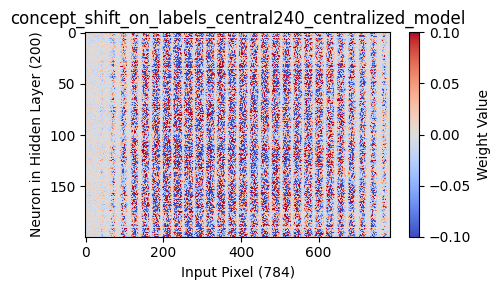

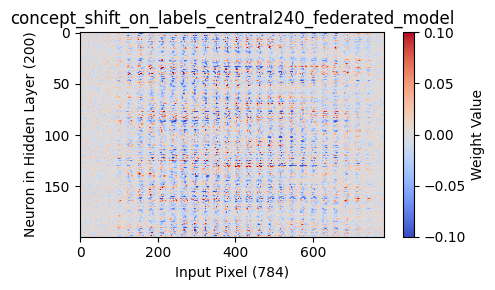

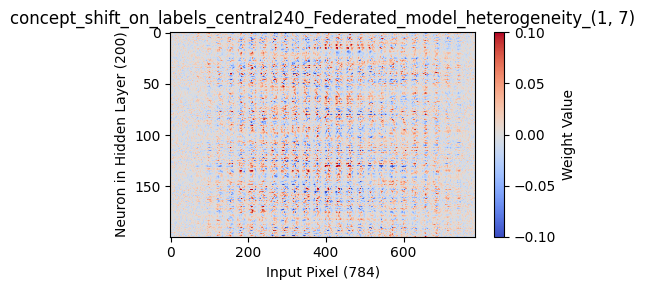

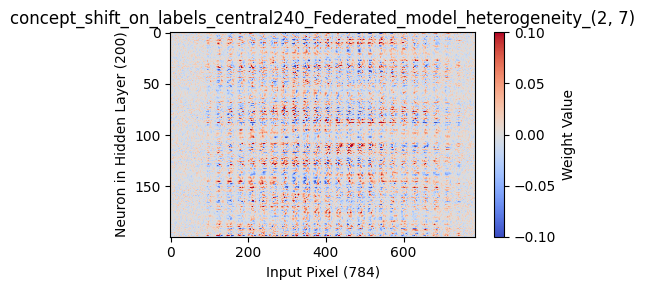

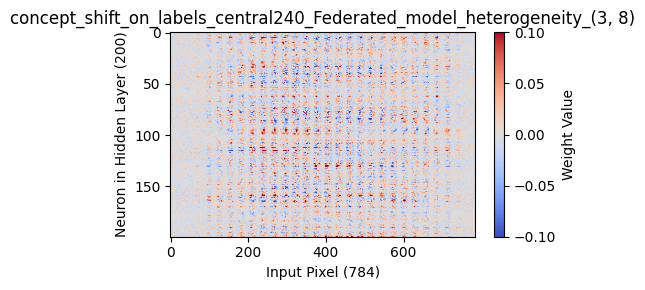

...

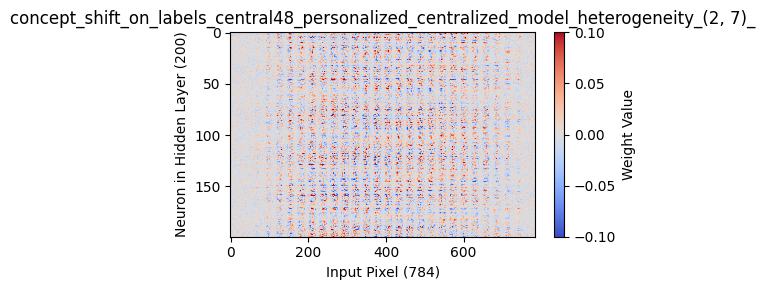

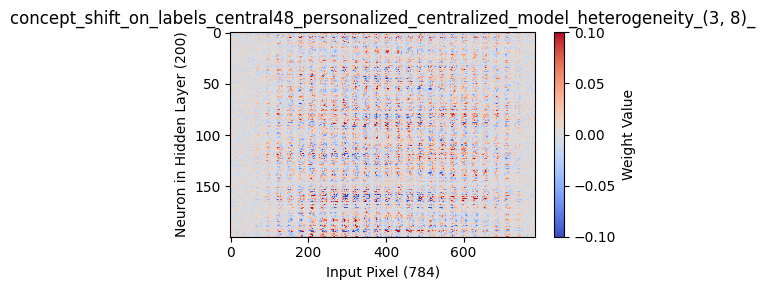

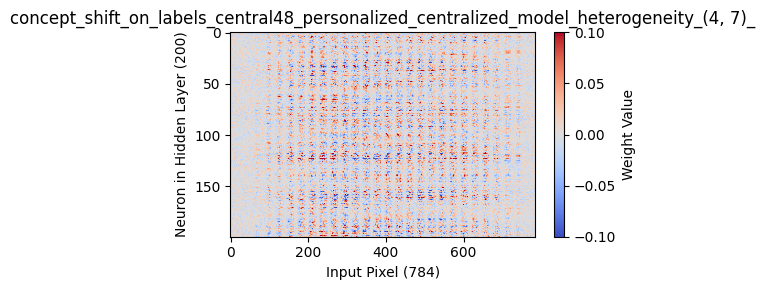

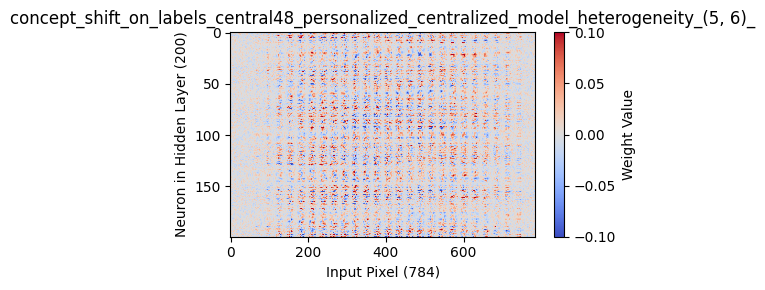

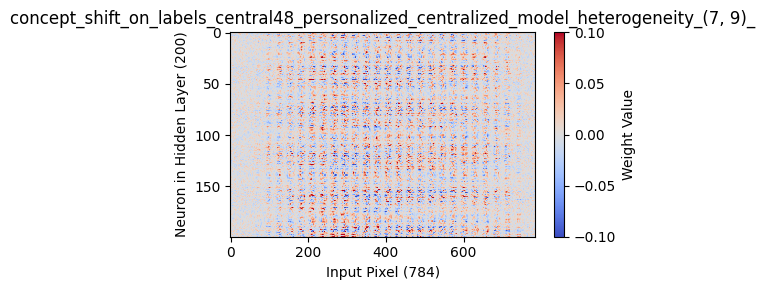

In [30]:
key_list =[]
for key in central_models_dict.keys() :
    key_list.append(key)
for key in key_list :
    model.load_state_dict(central_models_dict[key])
    plot_weights_heatmap(model,key)

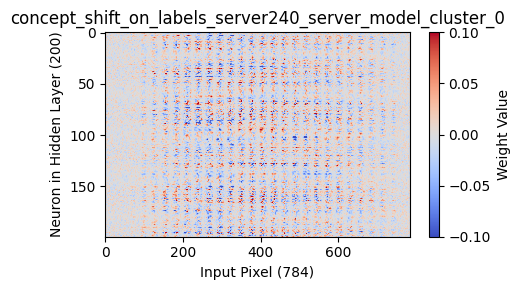

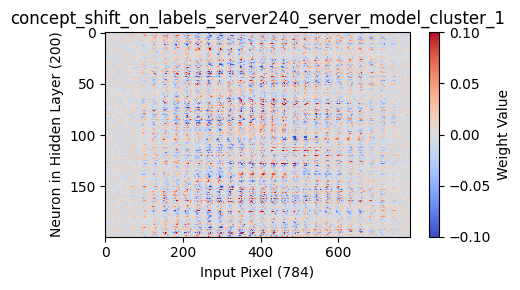

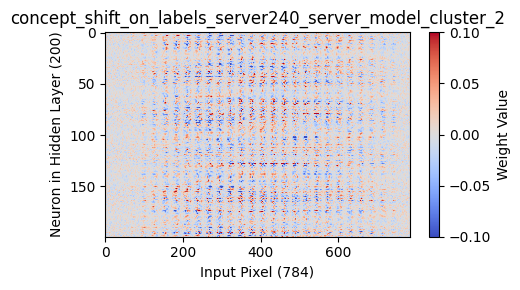

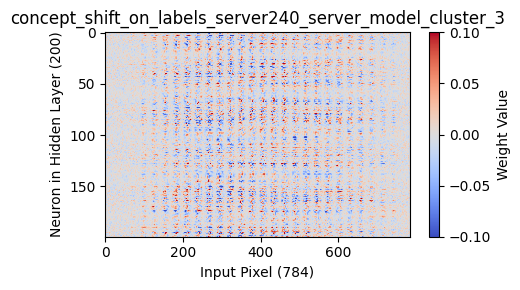

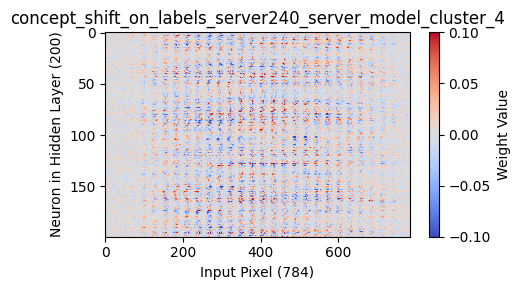

...

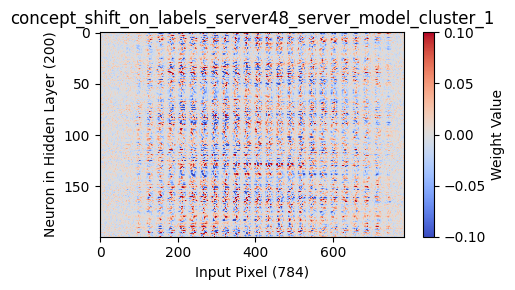

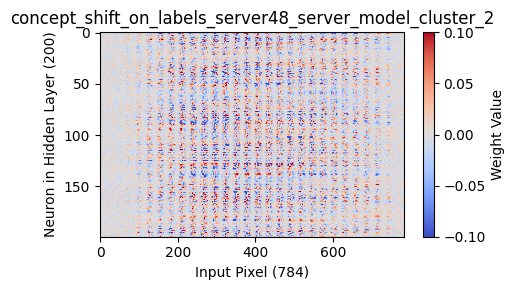

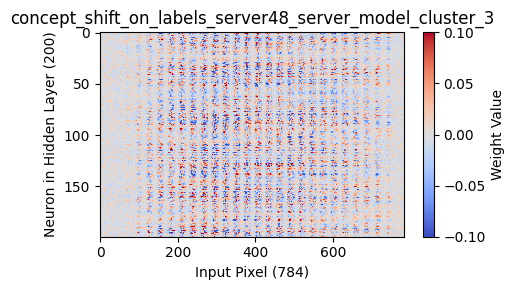

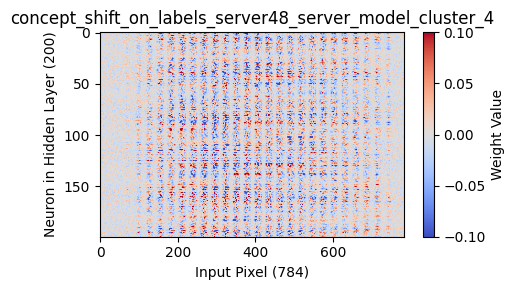

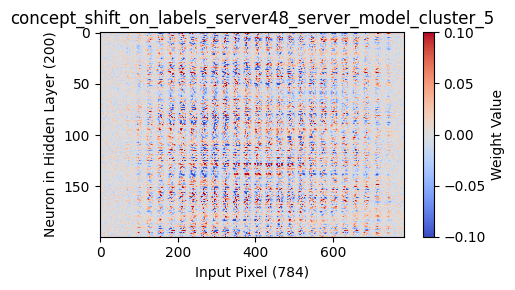

In [31]:
key_list =[]
for key in server_models_dict.keys() :
    key_list.append(key)
for key in key_list :
    model.load_state_dict(server_models_dict[key])
    plot_weights_heatmap(model,key)

# Similarity Matrix

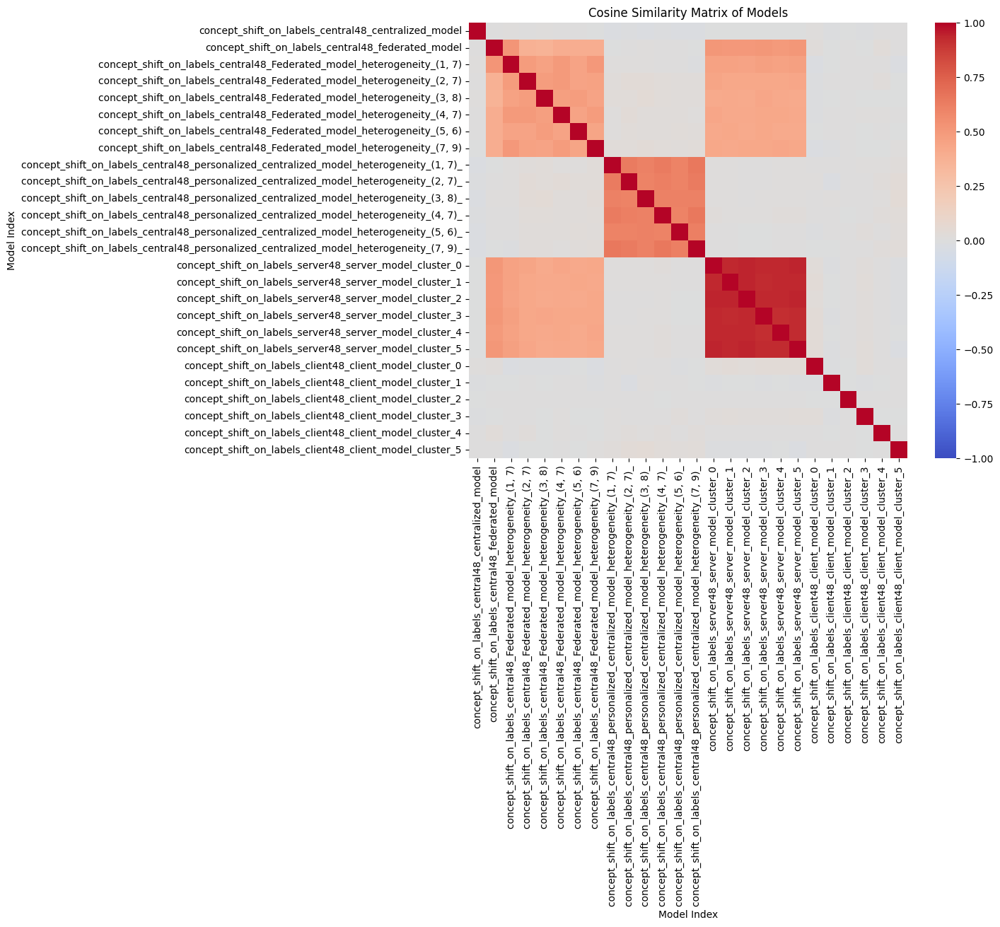

In [49]:
import torch
import glob
import os

from src.models import SimpleLinear
from src.metrics import plot_weights_heatmap
model = SimpleLinear()

# Define the directories
central_dir = "./results/concept_shift_on_labels_central48"
client_dir = "./results/concept_shift_on_labels_client48"
server_dir = "./results/concept_shift_on_labels_server48"

# Function to load .pth files from a directory into a dictionary
def load_pth_files(directory):
    pth_files = glob.glob(directory + "*.pth")
    models_dict = {}
    for pth_file in pth_files:
        filename = os.path.basename(pth_file)[:-4]  # Remove ".pth" extension
        model = torch.load(pth_file)
        models_dict[filename] = model
    return models_dict

# Load models from each directory
central_models_dict = load_pth_files(central_dir)
client_models_dict = load_pth_files(client_dir)
server_models_dict = load_pth_files(server_dir)
import torch
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
import matplotlib.pyplot as plt
key_list =[]
for key in central_models_dict.keys() :
  key_list.append(key)
for key in server_models_dict.keys() :
  key_list.append(key)
for key in client_models_dict.keys() :
  key_list.append(key)
# Load all the models using their state dicts
concatenated_dict = {}

concatenated_dict.update(central_models_dict)
concatenated_dict.update(server_models_dict)
concatenated_dict.update(client_models_dict)
models = []
for key in key_list:
    model = model = SimpleLinear()
  # Instantiate your PyTorch model
    model.load_state_dict(concatenated_dict[key])
    models.append(model)

# Extract parameters and flatten them
parameters = [torch.cat([param.view(-1) for param in model.parameters()]) for model in models]

# Compute cosine similarity matrix
cos_sim_matrix = cosine_similarity(torch.stack(parameters).detach().numpy())

# Plot heatmap with labels but without annotations
plt.figure(figsize=(10, 8))
sns.heatmap(cos_sim_matrix, cmap='coolwarm', center=0, xticklabels=key_list, yticklabels=key_list, annot=False, vmin=-1, vmax=1)
plt.title('Cosine Similarity Matrix of Models')
plt.xlabel('Model Index')
plt.ylabel('Model Index')
plt.show()

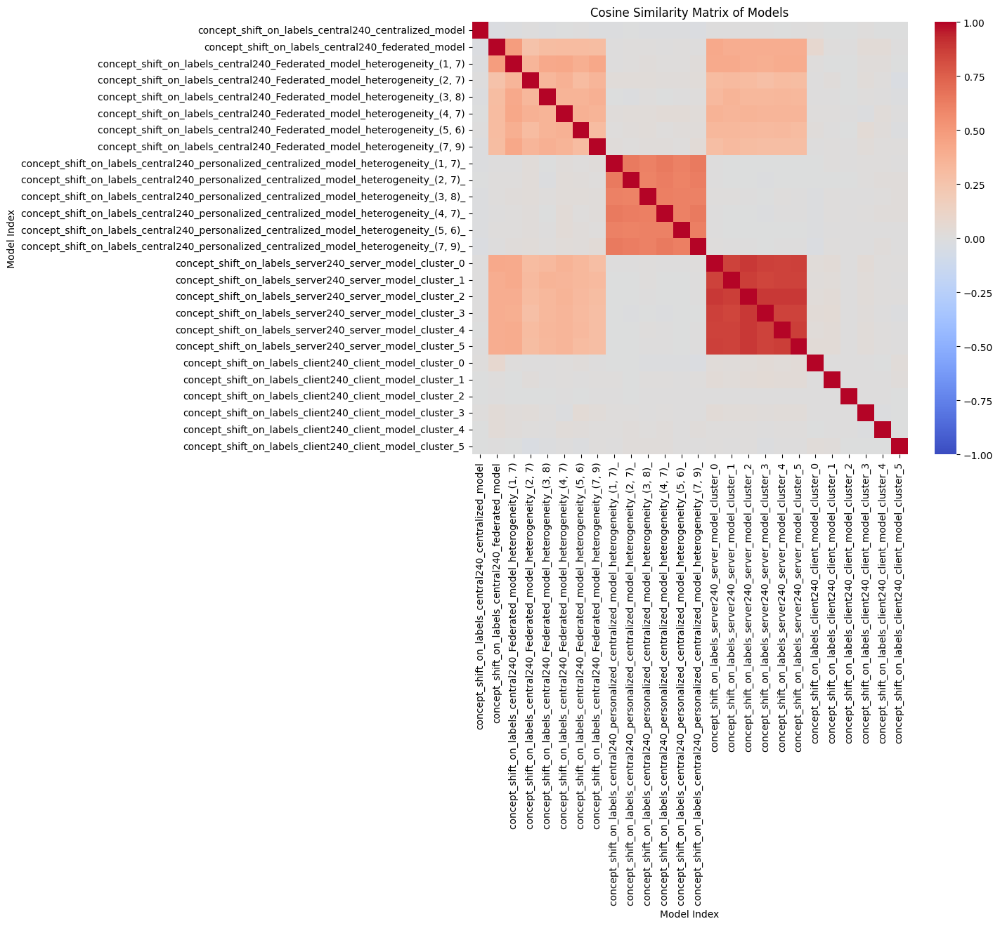

In [47]:
import torch
import glob
import os

from src.models import SimpleLinear
from src.metrics import plot_weights_heatmap
model = SimpleLinear()

# Define the directories
central_dir = "./results/concept_shift_on_labels_central240"
client_dir = "./results/concept_shift_on_labels_client240"
server_dir = "./results/concept_shift_on_labels_server240"

# Function to load .pth files from a directory into a dictionary
def load_pth_files(directory):
    pth_files = glob.glob(directory + "*.pth")
    models_dict = {}
    for pth_file in pth_files:
        filename = os.path.basename(pth_file)[:-4]  # Remove ".pth" extension
        model = torch.load(pth_file)
        models_dict[filename] = model
    return models_dict

# Load models from each directory
central_models_dict = load_pth_files(central_dir)
client_models_dict = load_pth_files(client_dir)
server_models_dict = load_pth_files(server_dir)
import torch
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
import matplotlib.pyplot as plt
key_list =[]
for key in central_models_dict.keys() :
  key_list.append(key)
for key in server_models_dict.keys() :
  key_list.append(key)
for key in client_models_dict.keys() :
  key_list.append(key)
# Load all the models using their state dicts
concatenated_dict = {}

concatenated_dict.update(central_models_dict)
concatenated_dict.update(server_models_dict)
concatenated_dict.update(client_models_dict)
models = []
for key in key_list:
    model = model = SimpleLinear()
  # Instantiate your PyTorch model
    model.load_state_dict(concatenated_dict[key])
    models.append(model)

# Extract parameters and flatten them
parameters = [torch.cat([param.view(-1) for param in model.parameters()]) for model in models]

# Compute cosine similarity matrix
cos_sim_matrix = cosine_similarity(torch.stack(parameters).detach().numpy())

# Plot heatmap with labels but without annotations
plt.figure(figsize=(10, 8))
sns.heatmap(cos_sim_matrix, cmap='coolwarm', center=0, xticklabels=key_list, yticklabels=key_list, annot=False, vmin=-1, vmax=1)
plt.title('Cosine Similarity Matrix of Models')
plt.xlabel('Model Index')
plt.ylabel('Model Index')
plt.show()

In [48]:
cos_sim_matrix

array([[ 1.00000596e+00, -1.70827396e-02, -1.17225144e-02,
         3.71917733e-03, -1.38718653e-02, -3.20176594e-04,
         5.22831222e-04, -7.97652919e-03, -1.22988680e-02,
        -5.09996107e-03, -1.18827047e-02, -1.16421161e-02,
        -1.03446255e-02, -1.66500378e-02,  2.73780827e-03,
         1.97862578e-03,  5.31254383e-03,  3.70640005e-03,
        -1.03010330e-04,  1.34711294e-03,  1.27422567e-02,
        -7.17515219e-03, -6.10132329e-03,  1.42516661e-02,
        -3.34290089e-05, -2.65695248e-03],
       [-1.70827396e-02,  1.00000203e+00,  4.80207086e-01,
         2.60798633e-01,  3.00943255e-01,  3.12465459e-01,
         3.10924143e-01,  2.98983723e-01,  2.62016850e-03,
         9.76190902e-03,  1.16232932e-02,  6.39931764e-03,
         8.88887513e-03,  4.17378079e-03,  4.16276008e-01,
         3.93993795e-01,  3.96935821e-01,  3.95198375e-01,
         3.96757245e-01,  3.96204442e-01,  7.70608410e-02,
         9.98754986e-03,  3.07853753e-03,  3.65813598e-02,
         3.20